## Import modules

In [38]:
import tensorflow as tf
import numpy as np
import os
import random
import shutil
from sklearn.manifold import TSNE
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from random import sample
import matplotlib.cm as cm

%matplotlib inline

In [2]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


### function definitions

In [15]:
# plot fitting accuracy (from lecture)

def plot_history(history):
    plt.style.use('default')
    # plot the development of the accuracy and loss during training
    plt.figure(figsize=(12,4))
    plt.subplot(1,2,(1))
    plt.plot(history.history['accuracy'],linestyle='-.')
    plt.plot(history.history['val_accuracy'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'valid'], loc='lower right')
    plt.subplot(1,2,(2))
    plt.plot(history.history['loss'],linestyle='-.')
    plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'valid'], loc='upper right')
    plt.show()

In [3]:
# functions to plot images with labels
# code inspired by https://www.tensorflow.org/tutorials/keras/classification

def plot_image(img, label_true, class_names, label_pred=[]):
    
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(img)

    label_t = np.argmax(label_true)

    if len(label_pred) > 0:
        label_p = np.argmax(label_pred)
        if label_p == label_t:
            color = 'black'
        else:
            color = 'red'
        plt.xlabel("{} {:2.0f}% ({})".format(class_names[label_p],
                                             100*np.max(label_pred),
                                             class_names[label_t]),
                                             color=color)
    else:
        plt.xlabel("{}".format(class_names[label_t]))

def plot_images(n, images, labels_true, class_names, labels_pred=[], sample_images=True):
    if sample_images:
        ind = sample(range(len(images)), n)
    else:
        ind = range(n)
    imgs = [img for i,img in enumerate(images) if i in ind]
    lab_t = [lab for i,lab in enumerate(labels_true) if i in ind]
    if len(labels_pred) > 0:
        lab_p = [lab for i,lab in enumerate(labels_pred) if i in ind]
    else:
        lab_p = [[] for i in ind]

    num_cols = 7
    num_rows = n // 7
    num_images = num_rows*num_cols
    plt.figure(figsize=(num_cols*3, num_rows*3))
    for i in range(num_images):
        plt.subplot(num_rows, num_cols, i+1)
        plot_image(imgs[i], lab_t[i], class_names, lab_p[i])
    plt.subplots_adjust(bottom=0.1)
    plt.show()

In [4]:
# CAM function
# https://towardsdatascience.com/class-activation-mapping-using-transfer-learning-of-resnet50-e8ca7cfd657e
# modified to work with the nested xception network (flattened in latest version)
# CAM not applicable here anyway as dense layer between last conv layer and prediction -> see gradient CAM below

import scipy

def get_class_activation_map(model, base_model, img):
    
    # expand dimension to fit the image to a network accepted input size
    img = np.expand_dims(img, axis=0)

    # predict to get the winning class
    predictions = model.predict(img)
    label_index = np.argmax(predictions)

    # Get the 2048 input weights to the softmax of the winning class.
    class_weights = model.layers[-1].get_weights()[0]
    class_weights_winner = class_weights[:, label_index]
    
    # get the final conv layer
    final_conv_layer = base_model.get_layer("block14_sepconv2_act")
    
    # create a function to fetch the final conv layer output maps (should be shape (1, 10, 10, 2048)) 
    #get_output = tf.keras.backend.function([model.layers[0].input],[final_conv_layer.output, model.layers[-1].output])
    #[conv_outputs, predictions] = get_output([img])

    model_stub = tf.keras.models.Model(inputs=base_model.input, outputs=base_model.get_layer("block14_sepconv2_act").output)
    conv_outputs = model_stub.predict(img)
    predictions = model.predict(img)

    # squeeze conv map to shape image to size (10, 10, 2048)
    conv_outputs = np.squeeze(conv_outputs)

    # bilinear upsampling to resize each filtered image to size of original image 
    mat_for_mult = scipy.ndimage.zoom(conv_outputs, (29.9, 29.9, 1), order=1) # dim: 299 x 299 x 2048

    # get class activation map for object class that is predicted to be in the image
    final_output = np.dot(mat_for_mult.reshape((299*299, 2048)), class_weights_winner).reshape(299,299) # dim: 299 x 299
    
    # return class activation map
    return final_output

# function to plot the cams together with original image
def plot_images_cam(n, images, labels_true, class_names, model, base_model, labels_pred=[], sample_images=True):
    if sample_images:
        ind = sample(range(len(images)), n)
    else:
        ind = range(n)
    imgs = [img for i,img in enumerate(images) if i in ind]
    lab_t = [lab for i,lab in enumerate(labels_true) if i in ind]
    if len(labels_pred) > 0:
        lab_p = [lab for i,lab in enumerate(labels_pred) if i in ind]
    else:
        lab_p = [[] for i in ind]

    cams = [get_class_activation_map(model, base_model, img) for img in imgs]

    num_cols = 5
    num_rows = n // 5
    num_images = num_rows*num_cols
    plt.figure(figsize=(num_cols*4, num_rows*4))
    for i in range(num_images):
        plt.subplot(num_rows, num_cols, i+1)
        plot_image(imgs[i], lab_t[i], class_names, lab_p[i])
        plt.imshow(cams[i], alpha=0.5)
    plt.subplots_adjust(bottom=0.1)
    plt.show()

In [58]:
# GradCAM
# https://keras.io/examples/vision/grad_cam/

def get_img_array(img_path, size=None):
    # `img` is a PIL image of size 299x299
    # img = keras.preprocessing.image.load_img(img_path, target_size=size)
    img = img_path
    # `array` is a float32 Numpy array of shape (299, 299, 3)
    array = keras.preprocessing.image.img_to_array(img)
    # We add a dimension to transform our array into a "batch"
    # of size (1, 299, 299, 3)
    array = np.expand_dims(array, axis=0)
    return array


def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    # First, we create a model that maps the input image to the activations
    # of the last conv layer as well as the output predictions
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )

    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

# modified save_and_display_gradcam
def display_gradcam(img, heatmap, label_true, class_names, label_pred=[], alpha=0.002):

    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet")

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = keras.preprocessing.image.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = keras.preprocessing.image.array_to_img(superimposed_img)

    # Display Grad CAM
    plot_image(superimposed_img, label_true, class_names, label_pred)

def plot_images_grad_cam(n, images, labels_true, class_names, model, labels_pred=[], sample_images=True):
    if sample_images:
        ind = sample(range(len(images)), n)
    else:
        ind = range(n)
    imgs = [img for i,img in enumerate(images) if i in ind]
    lab_t = [lab for i,lab in enumerate(labels_true) if i in ind]
    if len(labels_pred) > 0:
        lab_p = [lab for i,lab in enumerate(labels_pred) if i in ind]
    else:
        lab_p = [[] for i in ind]

    heatmaps = [make_gradcam_heatmap(get_img_array(img), model, 'block14_sepconv2_act') for img in imgs]

    num_cols = 5
    num_rows = n // 5
    num_images = num_rows*num_cols
    plt.figure(figsize=(num_cols*4, num_rows*4))
    for i in range(num_images):
        plt.subplot(num_rows, num_cols, i+1)
        display_gradcam(imgs[i], heatmaps[i], lab_t[i], class_names, lab_p[i])
    plt.subplots_adjust(bottom=0.1)
    plt.show()

## Test set generation

In [3]:
f_ausschuss = os.listdir("labeled data/ausschuss")
f_cat = os.listdir("labeled data/cat")
f_nocat = os.listdir("labeled data/nocat")

In [22]:
""" os.rmdir('test_data')
os.mkdir('test_data')
os.mkdir('test_data/ausschuss')
os.mkdir('test_data/cat')
os.mkdir('test_data/nocat') """

In [23]:
f_ausschuss_test = random.sample(f_ausschuss, k=int(len(f_ausschuss)*0.2))
f_cat_test = random.sample(f_cat, k=int(len(f_cat)*0.2))
f_nocat_test = random.sample(f_nocat, k=int(len(f_nocat)*0.2))

In [25]:
""" for f in f_ausschuss_test:
    shutil.move('labeled data/ausschuss/'+f, 'test_data/ausschuss/'+f) """

In [26]:
""" for f in f_cat_test:
    shutil.move('labeled data/cat/'+f, 'test_data/cat/'+f) """

In [27]:
""" for f in f_nocat_test:
    shutil.move('labeled data/nocat/'+f, 'test_data/nocat/'+f) """

## Image preprocessing

In [5]:
def norm(image,label):
    image = tf.cast(image/255. ,tf.float32)
    return image,label

In [6]:
data_train = tf.keras.preprocessing.image_dataset_from_directory(
    "labeled data/",
    label_mode='categorical',
    color_mode="rgb",
    batch_size=32,
    image_size=(299, 299),
    validation_split=0.2,
    subset='training',
    seed=1234
)
data_train = data_train.map(norm)

Found 12675 files belonging to 3 classes.
Using 10140 files for training.


In [7]:
data_val = tf.keras.preprocessing.image_dataset_from_directory(
    "labeled data/",
    label_mode='categorical',
    color_mode="rgb",
    image_size=(299, 299),
    validation_split=0.2,
    subset='validation',
    seed=1234
)
data_val = data_val.map(norm)

Found 12675 files belonging to 3 classes.
Using 2535 files for validation.


In [8]:
l1 = list(data_val.as_numpy_iterator())
val_labels = [item for sublist in [x[1] for x in l1] for item in sublist]
val_images = [item for sublist in [x[0] for x in l1] for item in sublist]

In [9]:
class_names = ['ausschuss', 'cat', 'nocat']

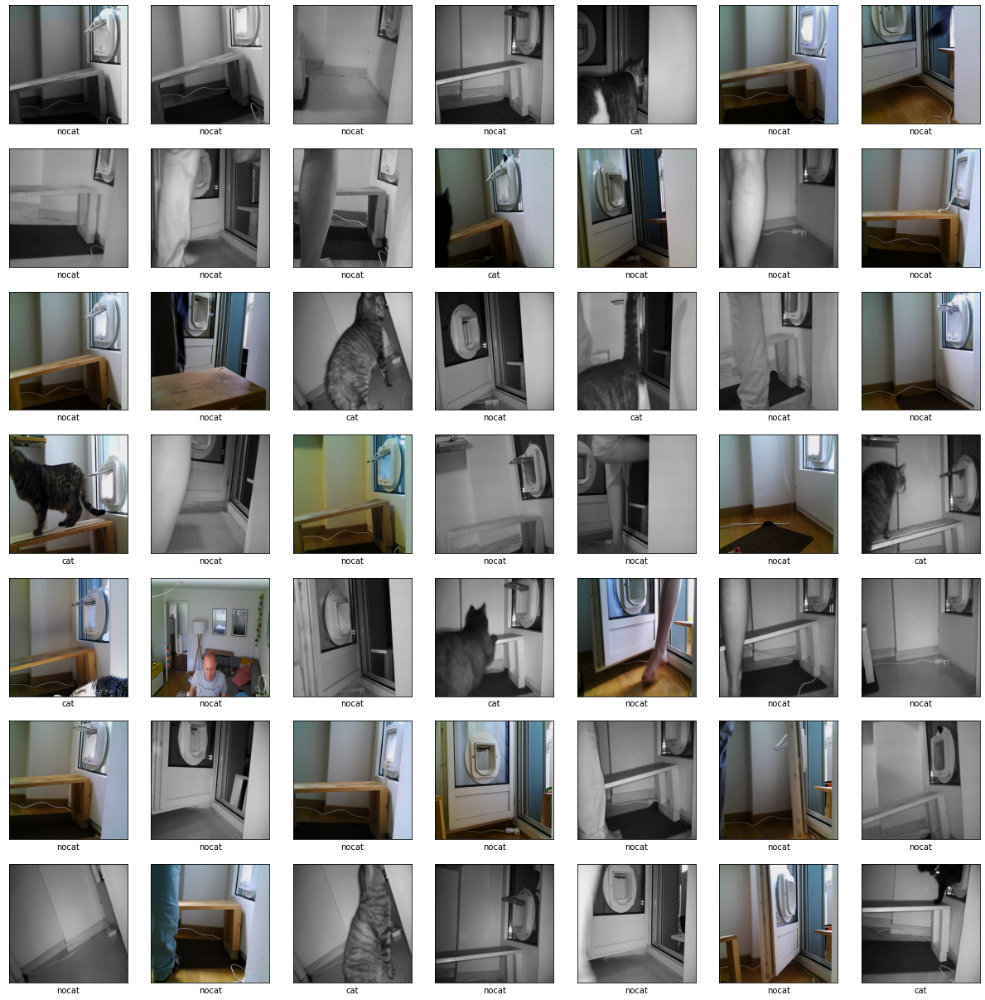

In [9]:
plot_images(50, val_images, val_labels, class_names)

## Feature extraction from pre-trained Xception net

In [127]:
model = tf.keras.applications.xception.Xception(weights='imagenet')
model.summary()

Model: "xception"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_2[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
___________________________________________________________________________________________

In [128]:
model_stub = tf.keras.models.Model(inputs=model.input, outputs=model.get_layer('avg_pool').output)
model_stub.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_2[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
____________________________________________________________________________________________

In [129]:
val_images[0].shape

(299, 299, 3)

In [131]:
features = model_stub.predict(np.array(val_images))

In [132]:
features.shape

(2535, 2048)

In [133]:
features_embedded = TSNE(n_components=2, init='pca').fit_transform(features)

<AxesSubplot:xlabel='tsne1', ylabel='tsne2'>

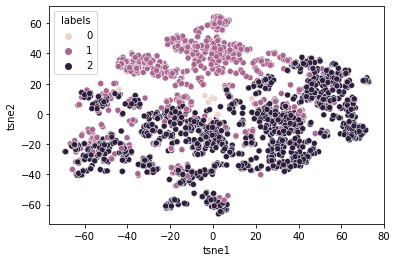

In [134]:
df = pd.DataFrame(features_embedded)
df.columns = ['tsne1', 'tsne2']
df['labels'] = np.array([np.argmax(x) for x in val_labels])
sns.scatterplot(data=df, x='tsne1', y='tsne2', hue='labels')

## retraining classification layer

In [10]:
from tensorflow import keras

# take base model and freeze
base_model = tf.keras.applications.xception.Xception(weights='imagenet', 
    include_top=False,
    input_shape=(299,299,3)
)
base_model.trainable = False

# set input shape
inputs = keras.Input(shape=(299, 299, 3))
# add inputs to base model
x = base_model.call(inputs, training=False) # NOT base_model(inputs, training=False) !! otherwise model is treated as layer and all the CAM funtions brake
# add pooling and last dense layer
x = keras.layers.GlobalAveragePooling2D()(x)
x = keras.layers.Dense(2048, activation='relu')(x)
# add classification layer
outputs = keras.layers.Dense(3, activation='softmax')(x)
# stick model together
model = keras.Model(inputs, outputs)

# compile
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [11]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_2[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[1][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[1][0]            
______________________________________________________________________________________________

In [12]:
# train the model
history=model.fit(data_train,
                  epochs=10,
                  verbose=1,
                  validation_data=data_val
                 )
model.save('model_new_classes')

Epoch 1/10
317/317 [==============================] - 309s 946ms/step - loss: 0.2746 - accuracy: 0.9162 - val_loss: 0.0821 - val_accuracy: 0.9763
Epoch 2/10
317/317 [==============================] - 181s 569ms/step - loss: 0.0908 - accuracy: 0.9741 - val_loss: 0.0649 - val_accuracy: 0.9811
Epoch 3/10
317/317 [==============================] - 195s 613ms/step - loss: 0.0668 - accuracy: 0.9796 - val_loss: 0.0663 - val_accuracy: 0.9815
Epoch 4/10
317/317 [==============================] - 195s 612ms/step - loss: 0.0612 - accuracy: 0.9814 - val_loss: 0.0621 - val_accuracy: 0.9826
Epoch 5/10
317/317 [==============================] - 184s 580ms/step - loss: 0.0471 - accuracy: 0.9865 - val_loss: 0.0615 - val_accuracy: 0.9842
Epoch 6/10
317/317 [==============================] - 181s 568ms/step - loss: 0.0492 - accuracy: 0.9849 - val_loss: 0.0583 - val_accuracy: 0.9846
Epoch 7/10
317/317 [==============================] - 187s 587ms/step - loss: 0.0450 - accuracy: 0.9846 - val_loss: 0.0578 -

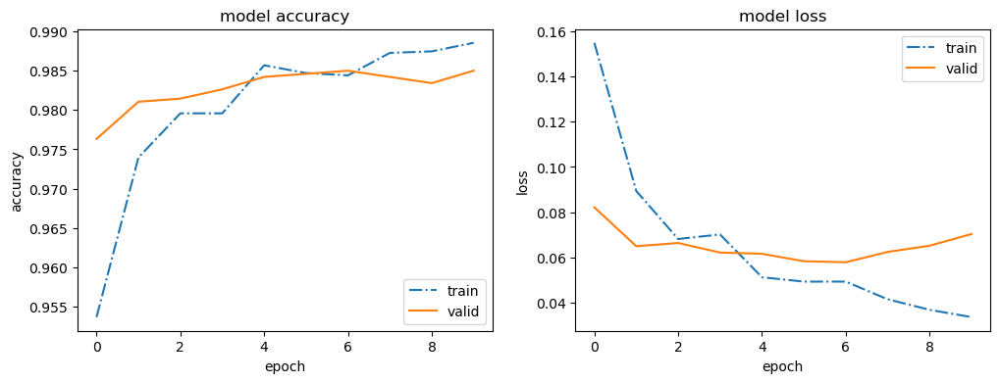

In [16]:
plot_history(history)

<AxesSubplot:xlabel='tsne1', ylabel='tsne2'>

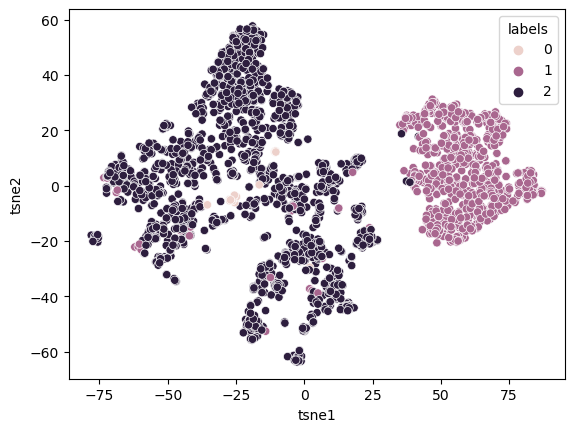

In [17]:
model_stub = tf.keras.models.Model(inputs=model.input, outputs=model.get_layer('dense').output)
features = model_stub.predict(np.array(val_images))
features_embedded = TSNE(n_components=2, init='pca').fit_transform(features)
df = pd.DataFrame(features_embedded)
df.columns = ['tsne1', 'tsne2']
df['labels'] = np.array([np.argmax(x) for x in val_labels])
sns.scatterplot(data=df, x='tsne1', y='tsne2', hue='labels')

### Visualize predictions

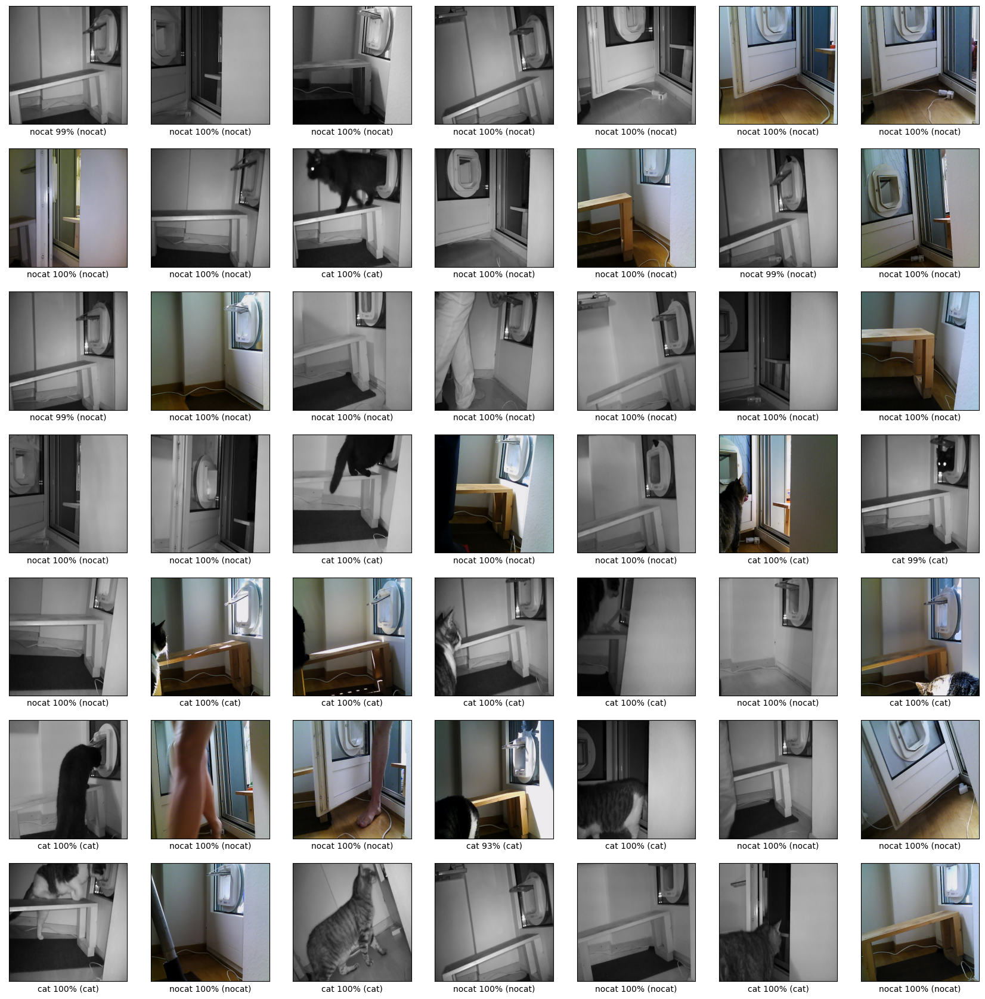

In [18]:
model = tf.keras.models.load_model("model_new_classes")
predictions = model.predict(np.array(val_images))
plot_images(50, val_images, val_labels, class_names, labels_pred=predictions)

## Dropout layers

In [19]:
from tensorflow import keras

# take base model and freeze
base_model = tf.keras.applications.xception.Xception(weights='imagenet', 
    include_top=False,
    input_shape=(299,299,3)
)
base_model.trainable = False

# set input shape
inputs = keras.Input(shape=(299, 299, 3))
# add inputs to base model
x = base_model.call(inputs, training=False) # NOT base_model(inputs, training=False) !! otherwise model is treated as layer and all the CAM funtions brake
# add pooling and last dense layer
x = keras.layers.GlobalAveragePooling2D()(x)
x = keras.layers.Dense(2048, activation='relu')(x)
x = keras.layers.Dropout(0.3)(x)
# add classification layer
outputs = keras.layers.Dense(3, activation='softmax')(x)
x = keras.layers.Dropout(0.3)(x)
# stick model together
model = keras.Model(inputs, outputs)

# compile
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_4[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[1][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[1][0]            
____________________________________________________________________________________________

In [20]:
# train the model
history=model.fit(data_train,
                  epochs=10,
                  verbose=1,
                  validation_data=data_val
                 )
model.save('model_new_classes_dropout')

Epoch 1/10
317/317 [==============================] - 192s 592ms/step - loss: 0.2737 - accuracy: 0.9120 - val_loss: 0.0748 - val_accuracy: 0.9791
Epoch 2/10
317/317 [==============================] - 214s 675ms/step - loss: 0.1017 - accuracy: 0.9711 - val_loss: 0.0857 - val_accuracy: 0.9775
Epoch 3/10
317/317 [==============================] - 219s 688ms/step - loss: 0.0839 - accuracy: 0.9740 - val_loss: 0.0692 - val_accuracy: 0.9795
Epoch 4/10
317/317 [==============================] - 254s 800ms/step - loss: 0.0655 - accuracy: 0.9809 - val_loss: 0.0704 - val_accuracy: 0.9819
Epoch 5/10
317/317 [==============================] - 234s 733ms/step - loss: 0.0555 - accuracy: 0.9837 - val_loss: 0.1006 - val_accuracy: 0.9767
Epoch 6/10
317/317 [==============================] - 223s 702ms/step - loss: 0.0642 - accuracy: 0.9823 - val_loss: 0.0563 - val_accuracy: 0.9838
Epoch 7/10
317/317 [==============================] - 218s 683ms/step - loss: 0.0482 - accuracy: 0.9851 - val_loss: 0.1215 -

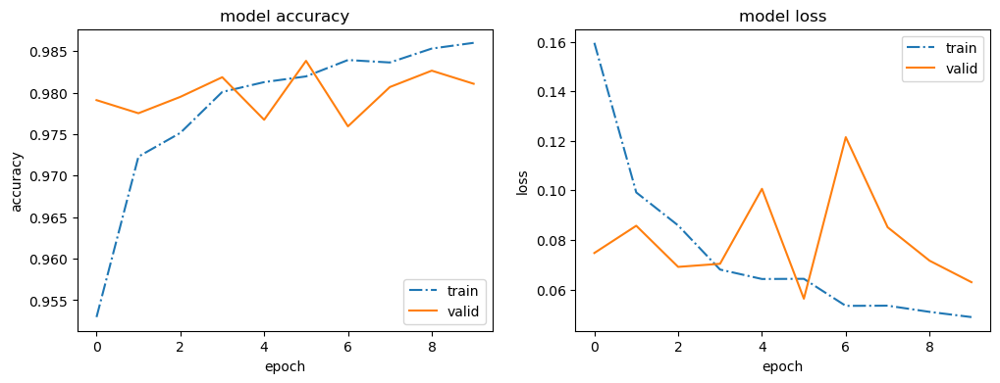

In [21]:
plot_history(history)

### Visualize predictions and groups

In [22]:
model = tf.keras.models.load_model("model_new_classes_dropout")
predictions = model.predict(np.array(val_images))

<AxesSubplot:xlabel='tsne1', ylabel='tsne2'>

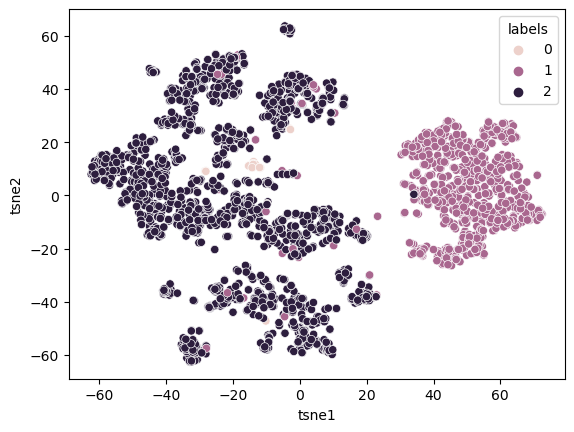

In [25]:
model_stub = tf.keras.models.Model(inputs=model.input, outputs=model.get_layer('dense_2').output)
features = model_stub.predict(np.array(val_images))
features_embedded = TSNE(n_components=2, init='pca').fit_transform(features)
df = pd.DataFrame(features_embedded)
df.columns = ['tsne1', 'tsne2']
df['labels'] = np.array([np.argmax(x) for x in val_labels])
sns.scatterplot(data=df, x='tsne1', y='tsne2', hue='labels')

<AxesSubplot:xlabel='tsne1', ylabel='tsne2'>

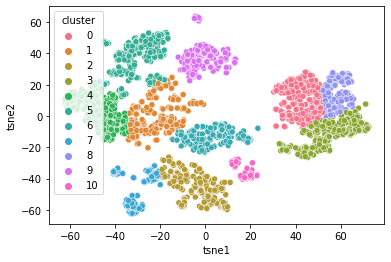

In [68]:
from sklearn.mixture import GaussianMixture
cluster = GaussianMixture(n_components=11,
                          covariance_type='full', 
                          max_iter=20, 
                          random_state=1234)
cluster.fit(features_embedded)
clus = cluster.fit_predict(features_embedded)
df['cluster'] =  pd.Series(clus, dtype="category")
sns.scatterplot(data=df, x='tsne1', y='tsne2', hue='cluster')

#### misclassified images

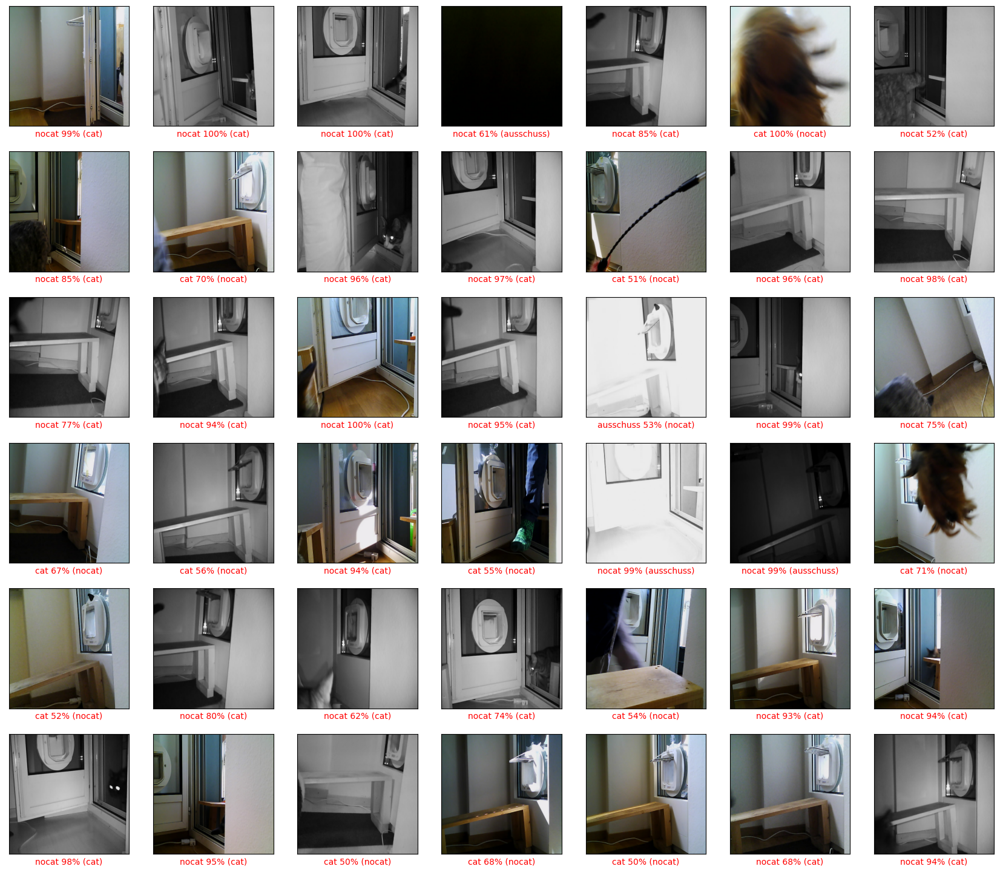

In [28]:
ind = [i for i,x in enumerate(np.array([np.argmax(x) for x in val_labels]) != np.array([np.argmax(x) for x in predictions])) if x]
plot_images(len(ind), [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, labels_pred=predictions[ind])

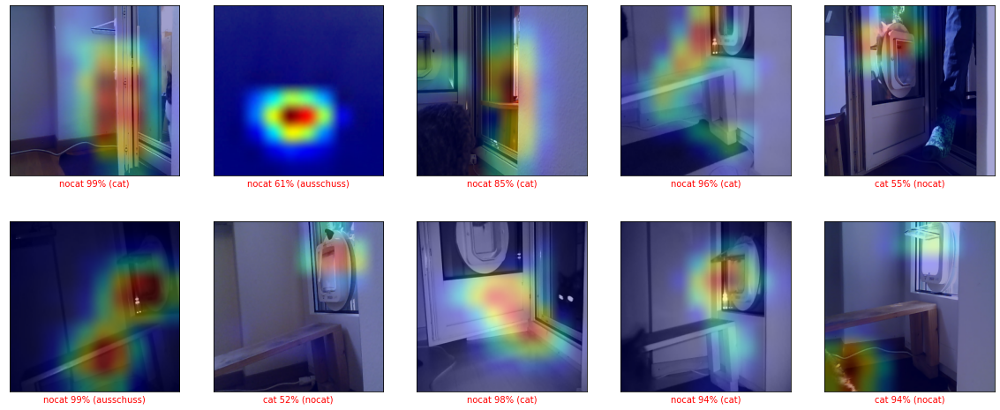

In [59]:
plot_images_grad_cam(10, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, labels_pred=predictions[ind], sample_images=True)

#### cat subgroups

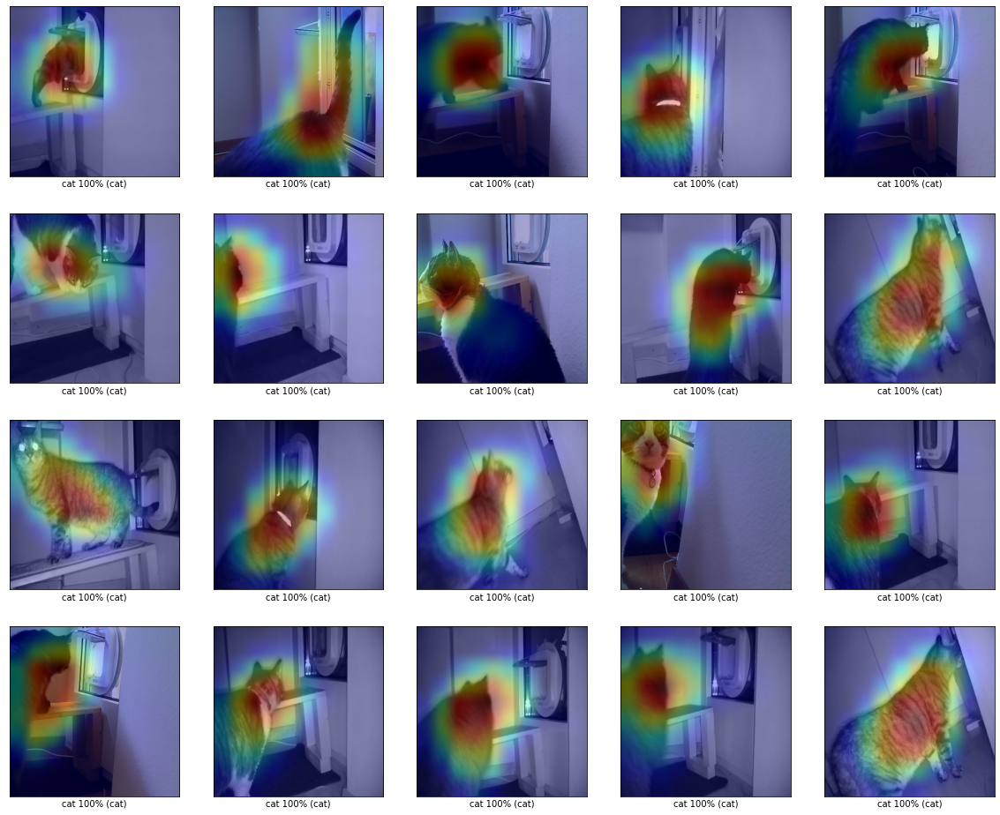

In [69]:
ind = np.where(clus == 8)[0]
plot_images_grad_cam(20, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, labels_pred=predictions[ind], sample_images=True)

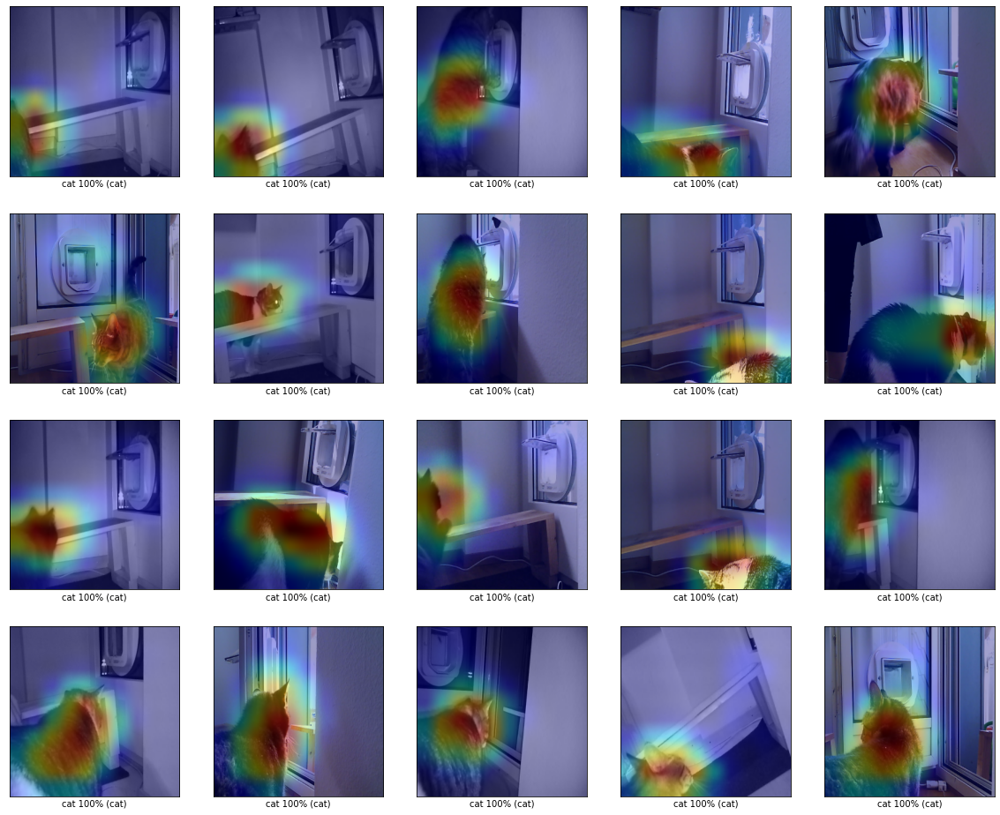

In [70]:
ind = np.where(clus == 0)[0]
plot_images_grad_cam(20, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, labels_pred=predictions[ind], sample_images=True)

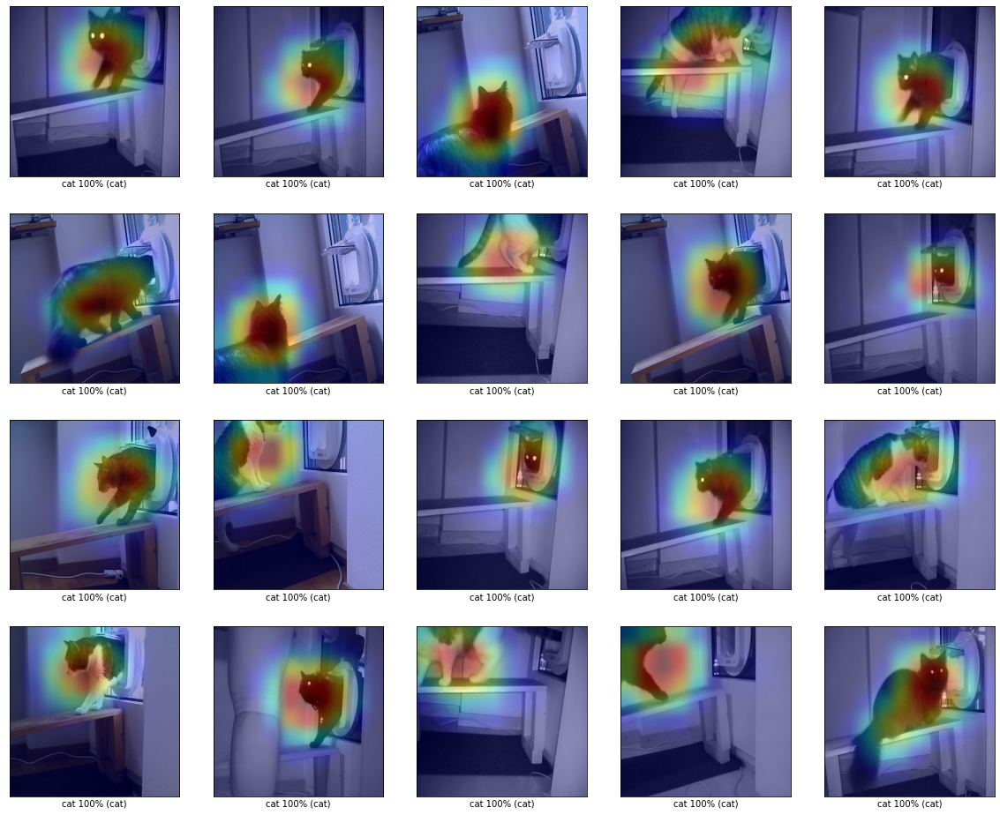

In [71]:
ind = np.where(clus == 3)[0]
plot_images_grad_cam(20, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, labels_pred=predictions[ind], sample_images=True)

#### nocat subgroups

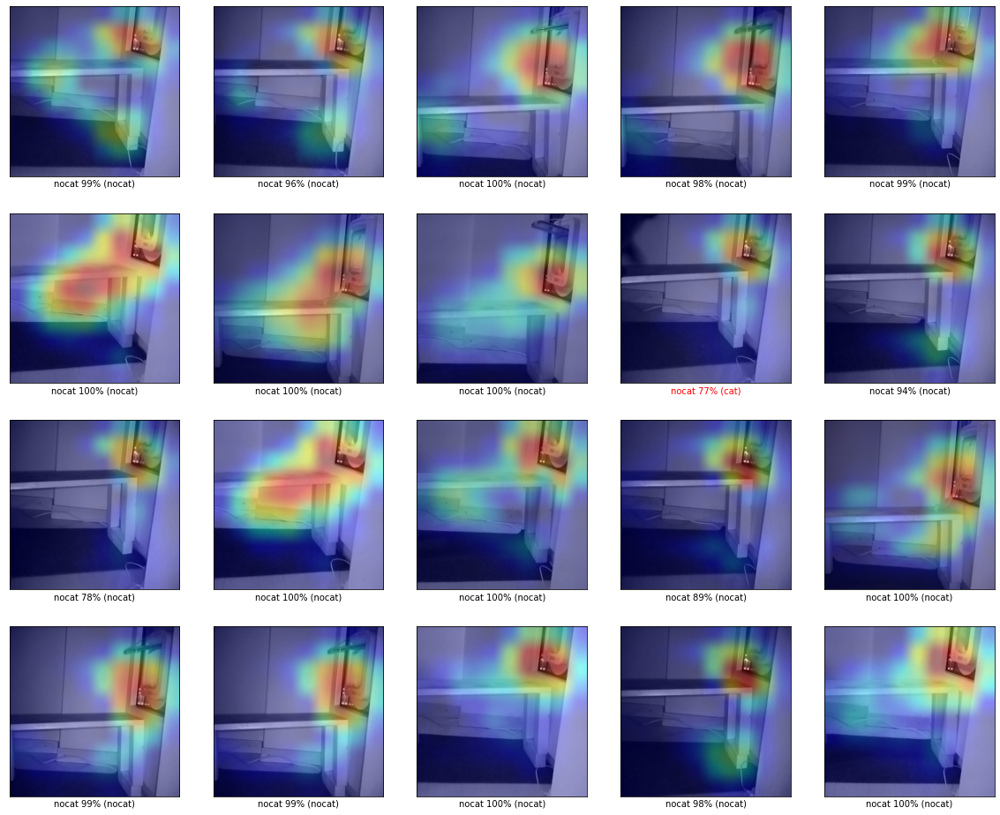

In [73]:
ind = np.where(clus == 10)[0]
plot_images_grad_cam(20, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, labels_pred=predictions[ind], sample_images=True)

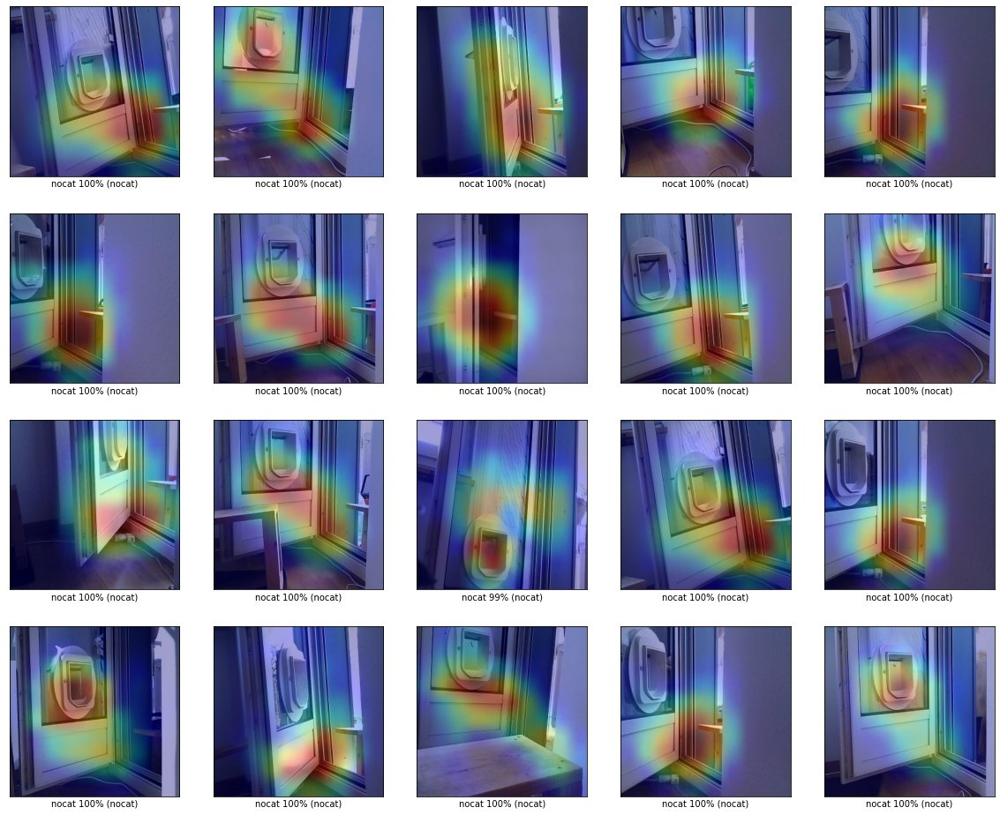

In [74]:
ind = np.where(clus == 5)[0]
plot_images_grad_cam(20, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, labels_pred=predictions[ind], sample_images=True)

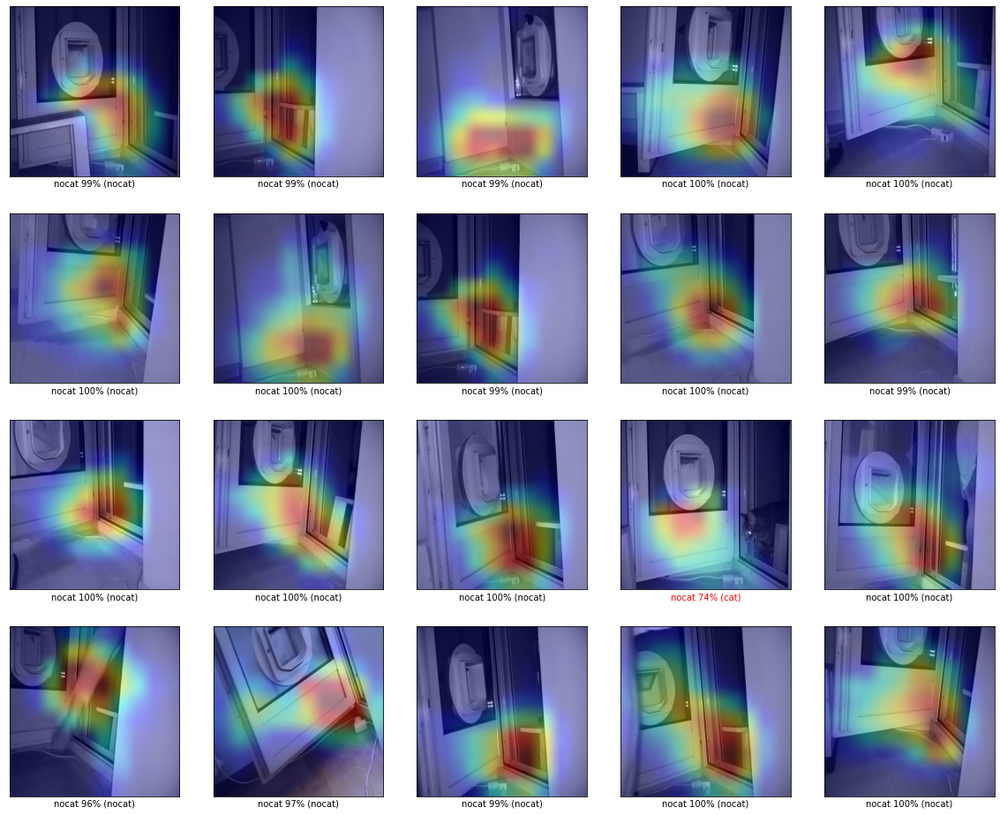

In [75]:
ind = np.where(clus == 9)[0]
plot_images_grad_cam(20, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, labels_pred=predictions[ind], sample_images=True)

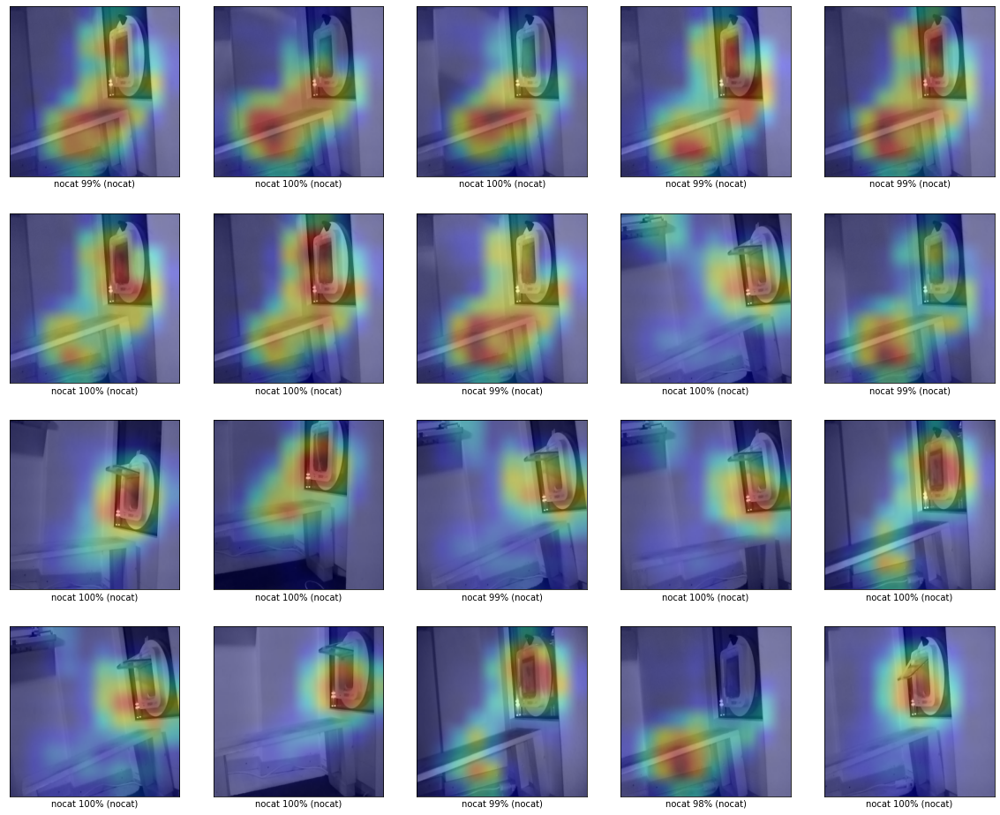

In [76]:
ind = np.where(clus == 7)[0]
plot_images_grad_cam(20, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, labels_pred=predictions[ind], sample_images=True)

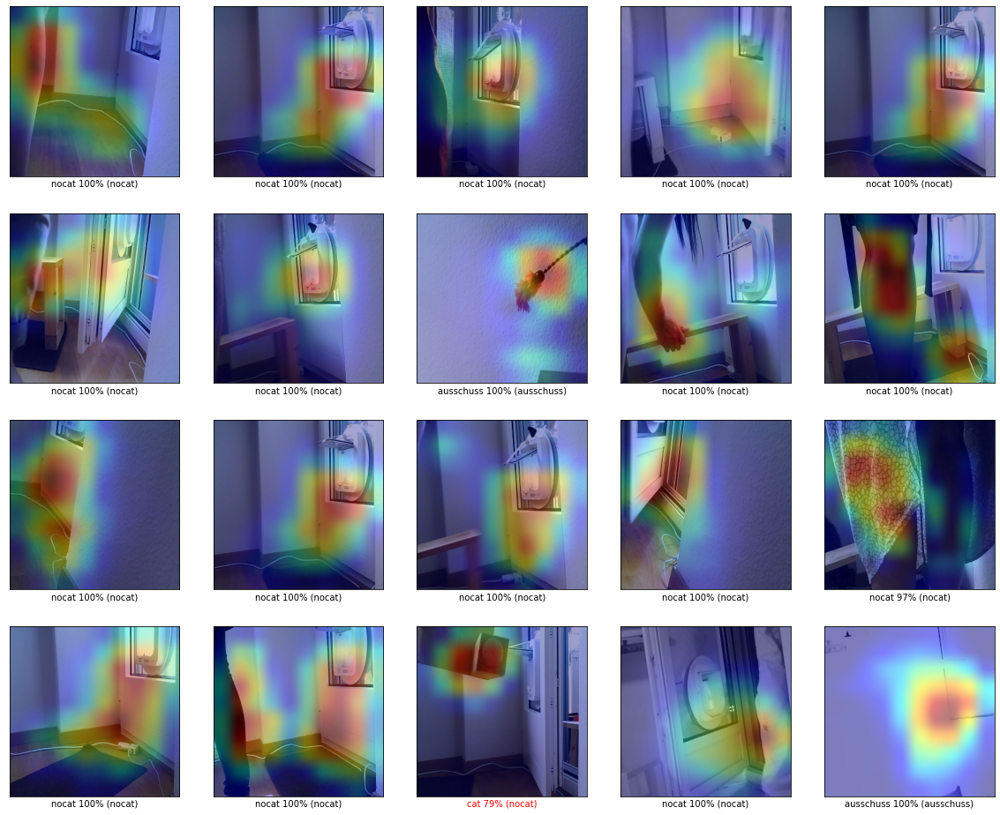

In [77]:
ind = np.where(clus == 1)[0]
plot_images_grad_cam(20, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, labels_pred=predictions[ind], sample_images=True)

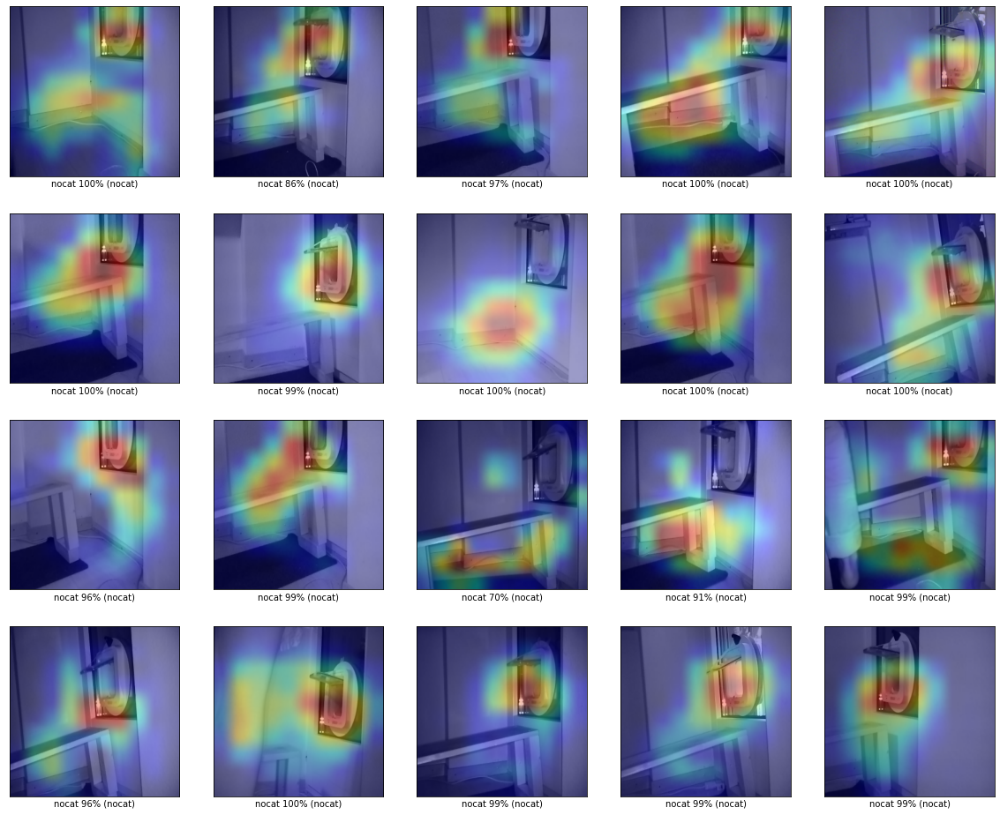

In [78]:
ind = np.where(clus == 2)[0]
plot_images_grad_cam(20, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, labels_pred=predictions[ind], sample_images=True)

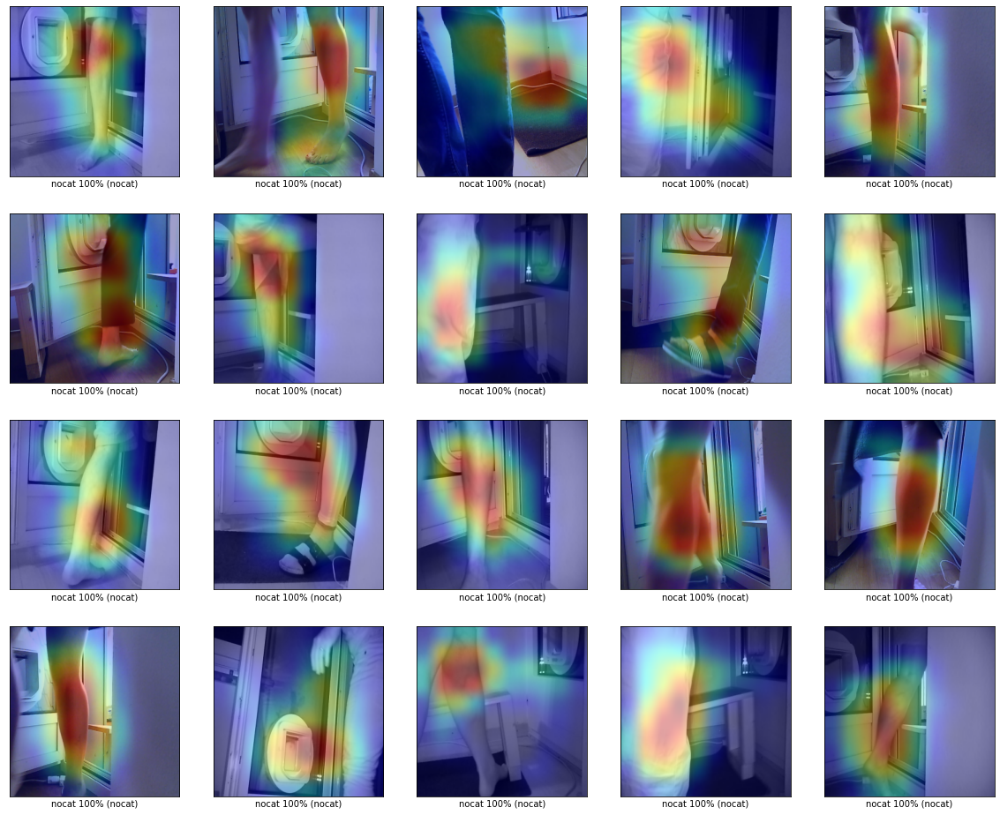

In [79]:
ind = np.where(clus == 4)[0]
plot_images_grad_cam(20, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, labels_pred=predictions[ind], sample_images=True)

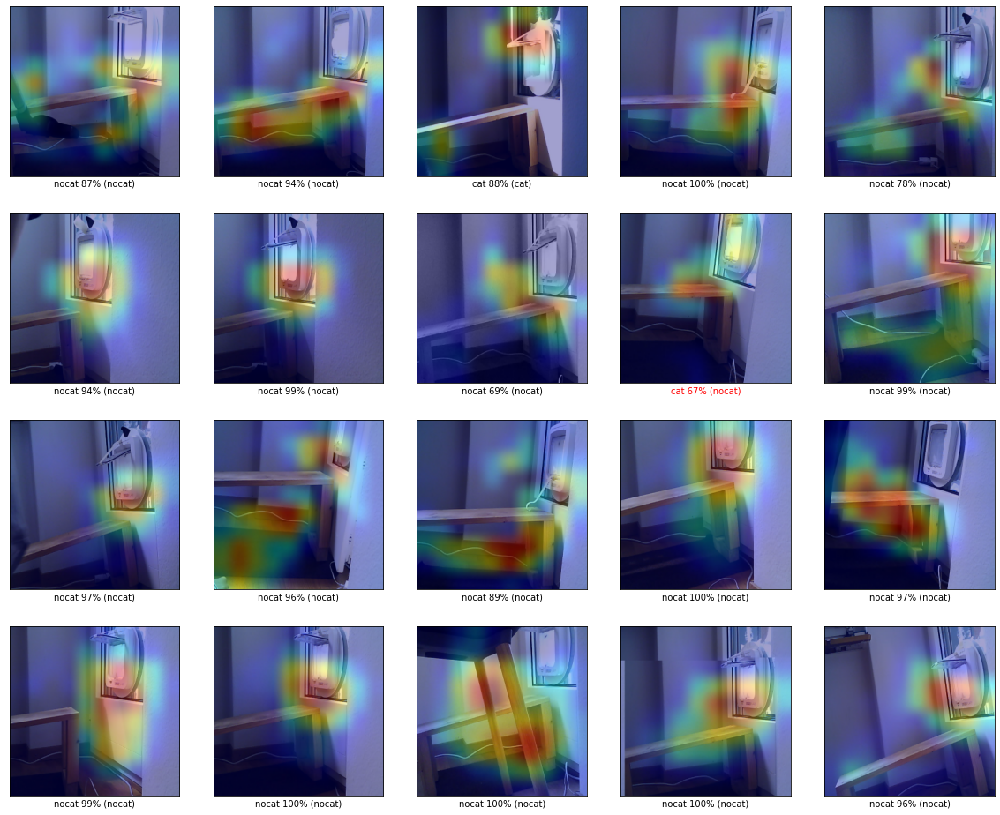

In [80]:
ind = np.where(clus == 6)[0]
plot_images_grad_cam(20, [x for i,x in enumerate(val_images) if i in ind], [x for i,x in enumerate(val_labels) if i in ind], class_names, model, labels_pred=predictions[ind], sample_images=True)